In [225]:
import pandas

df7 = pandas.read_excel("weather_kyiv_1881_2020_more_refined.xlsx",
             sheet_name='merged')
print(df7.shape)
print(df7.dtypes)

(50250, 8)
DAILY_MIN     float64
DAILY_MAX     float64
DAILY_MEAN    float64
DAY             int64
DAY_NB          int64
MONTH           int64
YEAR            int64
DATE           object
dtype: object


In [138]:
df7

,DAILY_MIN,DAILY_MAX,DAILY_MEAN,DAY,DAY_NB,MONTH,YEAR,DATE
0,-0.6,2.2,1.4000,1,1,1,1881,1881-01-01 00:00:00
1,-5.5,1.0,-2.9000,2,2,1,1881,1881-01-02 00:00:00
2,-7.2,-2.1,-4.8000,3,3,1,1881,1881-01-03 00:00:00
3,-5.1,0.1,-3.6000,4,4,1,1881,1881-01-04 00:00:00
4,-6.9,0.6,-0.9000,5,5,1,1881,1881-01-05 00:00:00
...,...,...,...,...,...,...,...,...
50245,3.0,12.9,8.2500,11,101,4,2020,2020-04-11 00:00:00
50246,1.3,12.1,7.2125,12,102,4,2020,2020-04-12 00:00:00
50247,4.1,20.6,12.2125,13,103,4,2020,2020-04-13 00:00:00
50248,1.6,15.3,6.7250,14,104,4,2020,2020-04-14 00:00:00


In [18]:
import plotly.graph_objects as go

years = df7.YEAR
nb=df7.DAY_NB
colored= df7.DAILY_MEAN

tickvalsX = [15.25, 45.75, 76.25, 106.75, 137.25, 167.75, 198.25, 228.75, 259.25, 289.75, 320.25, 350.75]
ticktextX = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']


fig = go.Figure(data=go.Heatmap(
        z=colored,
        x=nb, colorscale = 'RdBu',  reversescale=True,
        y=years, connectgaps=False, colorbar={"title": 'T, °C'} ) )


fig.update_layout( 
    
    width=900, height=800,
    title='MEAN TEMPERATURE MAP 1881-2020, Kyiv',
    xaxis_title="Month",
    yaxis_title="Year",
    font=dict(
        family="Courier New, monospace",
        size=16,
        color="black"),
    title_x=0.5,
    title_y= 0.93,
    xaxis = dict(
        tickvals = tickvalsX ,
        ticktext = ticktextX,
        ticks="outside",
        tickwidth=3, tickcolor='black',
        tickangle=270,
    ),
    yaxis = dict(
        tick0=1880 ,
        dtick = 10,
        ticks="outside",
        tickwidth=3, tickcolor='black'
    )
)


fig.show()

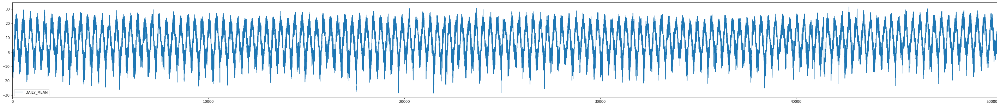

In [7]:
from matplotlib import pyplot
import matplotlib
matplotlib.rc('figure', figsize=(50, 5))

dates=df7.DATE;
values=df7.DAILY_MEAN;
series = values.to_frame().join(dates)
series.plot()
pyplot.show()

In [31]:
import plotly.express as px


dates=df7.DATE;
values=df7.DAILY_MEAN;
values2 = df7.DAILY_MIN
fig = px.line( x=dates, y=values)
_=px.line( x=dates, y=values2)
fig.show()

0         1.4000
1        -2.9000
2        -4.8000
3        -3.6000
4        -0.9000
          ...   
50245     8.2500
50246     7.2125
50247    12.2125
50248     6.7250
50249     4.1500
Name: DAILY_MEAN, Length: 50250, dtype: float64
50250


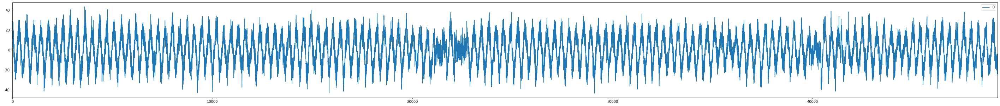

In [15]:
import pandas as pd
X = series.DAILY_MEAN
print(X)
print(len(X))
diff = []
days_in_year = 1000
for i in range(days_in_year, len(X)):
    value = float(X[i]) - float(X[i - days_in_year])
    diff.append(value)
    
dates=df7.DATE
series = pd.Series(diff).to_frame().join(dates)
series.plot()
pyplot.show()

pandas.core.series.Series

In [32]:
import plotly.graph_objects as go

# Add data
month = ['January', 'February', 'March', 'April', 'May', 'June', 'July',
         'August', 'September', 'October', 'November', 'December']
high_2000 = [32.5, 37.6, 49.9, 53.0, 69.1, 75.4, 76.5, 76.6, 70.7, 60.6, 45.1, 29.3]
low_2000 = [13.8, 22.3, 32.5, 37.2, 49.9, 56.1, 57.7, 58.3, 51.2, 42.8, 31.6, 15.9]
high_2007 = [36.5, 26.6, 43.6, 52.3, 71.5, 81.4, 80.5, 82.2, 76.0, 67.3, 46.1, 35.0]
low_2007 = [23.6, 14.0, 27.0, 36.8, 47.6, 57.7, 58.9, 61.2, 53.3, 48.5, 31.0, 23.6]
high_2014 = [28.8, 28.5, 37.0, 56.8, 69.7, 79.7, 78.5, 77.8, 74.1, 62.6, 45.3, 39.9]
low_2014 = [12.7, 14.3, 18.6, 35.5, 49.9, 58.0, 60.0, 58.6, 51.7, 45.2, 32.2, 29.1]

fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=month, y=high_2014, name='High 2014',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=month, y=low_2014, name = 'Low 2014',
                         line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=month, y=high_2007, name='High 2007',
                         line=dict(color='firebrick', width=4,
                              dash='dash') # dash options include 'dash', 'dot', and 'dashdot'
))
fig.add_trace(go.Scatter(x=month, y=low_2007, name='Low 2007',
                         line = dict(color='royalblue', width=4, dash='dash')))
fig.add_trace(go.Scatter(x=month, y=high_2000, name='High 2000',
                         line = dict(color='firebrick', width=4, dash='dot')))
fig.add_trace(go.Scatter(x=month, y=low_2000, name='Low 2000',
                         line=dict(color='royalblue', width=4, dash='dot')))

# Edit the layout
fig.update_layout(title='Average High and Low Temperatures in New York',
                   xaxis_title='Month',
                   yaxis_title='Temperature (degrees F)')


fig.show()

In [27]:
span = SpanSelector(ax1, onselect, 'horizontal', useblit=True,
                    rectprops=dict(alpha=0.5, facecolor='red'))
# Set useblit=True on most backends for enhanced performance.


plt.show()

In [40]:
import plotly.graph_objects as go

# Add data
month = df7.DATE
t_mean = df7.DAILY_MEAN
t_min = df7.DAILY_MIN
t_max = df7.DAILY_MAX


fig = go.Figure()
# Create and style traces
fig.add_trace(go.Scatter(x=month, y=t_mean, name='T MEAN',
                         line=dict(color='green', width=2)))
fig.add_trace(go.Scatter(x=month, y=t_min, name = 'T MIN',
                         line=dict(color='royalblue', width=2, dash = 'dot')))

fig.add_trace(go.Scatter(x=month, y=t_max, name = 'T MAX',
                         line=dict(color='firebrick', width=2, dash='dash')))

#fig.add_trace(go.Scatter(x=month, y=high_2007, name='High 2007',
#                         line=dict(color='firebrick', width=4,
#                              dash='dash') # dash options include 'dash', 'dot', and 'dashdot'
#))



# Edit the layout
fig.update_layout(title='Average, High and Low Temperatures in Kyiv, 1881-2020',
                   xaxis_title='Time, (years)',
                   yaxis_title='Temperature (°C)')


fig.show()

In [44]:
import plotly as py
import plotly.tools as tls
from scipy.optimize import curve_fit
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as dates

def line(x, a, b):
    return a * x + b

popt, pcov = curve_fit(line, trend_dates.ravel(), trend_lines.ravel())

fig1 = plt.figure(figsize=(8,6))
plt.plot_date(new_x, trend_lines, 'o', label='Lines')
z = np.polyfit(new_x, trend_lines, 1)
p = np.poly1d(z)
plt.plot(new_x, p(new_x), '-', label='Fit')
plt.title('Lines per day')
fig = tls.mpl_to_plotly(fig1)
fig['layout'].update(showlegend=True)
fig.strip_style()
py.iplot(fig)

NameError: name 'trend_dates' is not defined

<IPython.core.display.Javascript object>


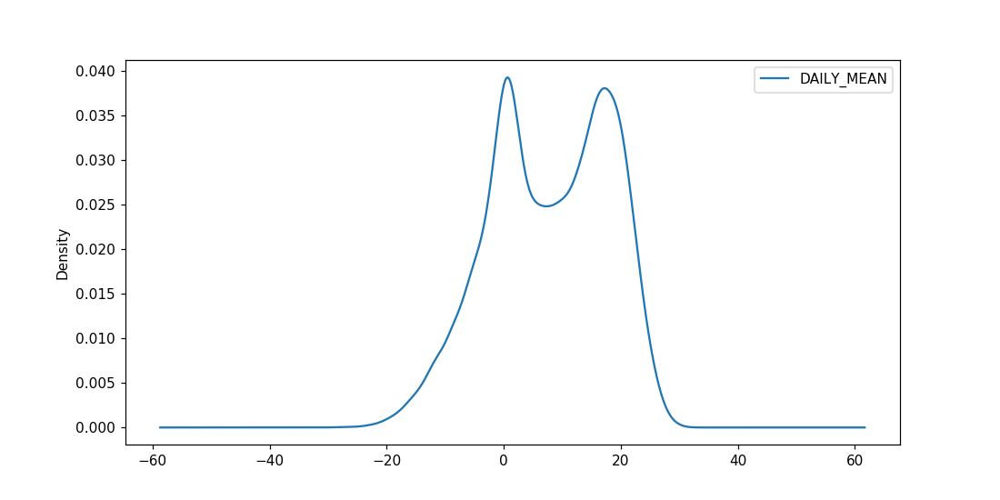

In [47]:
from matplotlib import pyplot
import matplotlib

matplotlib.rc('figure', figsize=(10, 5))

dates=df7.DATE;
values=df7.DAILY_MEAN;
series = pd.DataFrame(values)

series.plot(kind='kde')
pyplot.show()

<IPython.core.display.Javascript object>


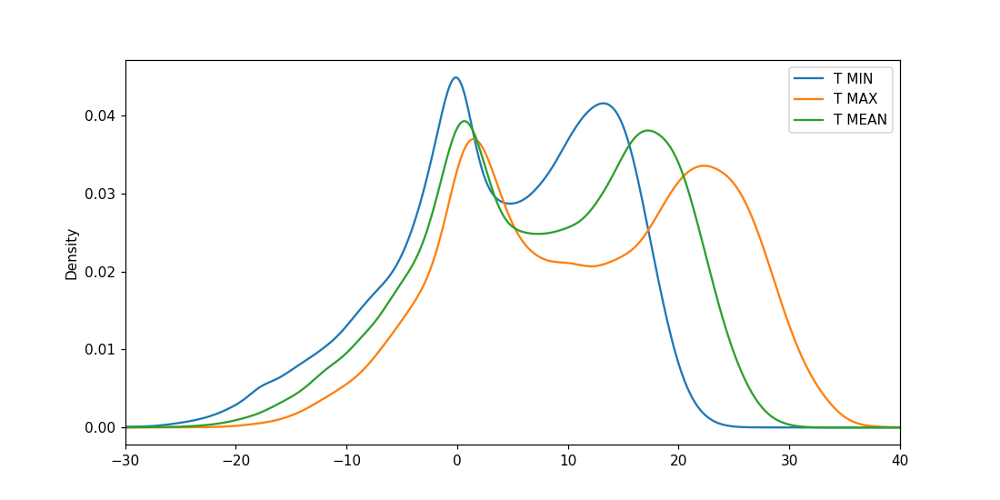

(-30, 40)

In [57]:
from matplotlib import pyplot
import matplotlib

matplotlib.rc('figure', figsize=(10, 5))

series = pd.DataFrame({
    'T MIN': list(df7.DAILY_MIN),
    "T MAX": list(df7.DAILY_MAX),
    'T MEAN': list(df7.DAILY_MEAN),
})

ax = series.plot.kde()
ax.set_xlim(left = -30, right=40)

<IPython.core.display.Javascript object>


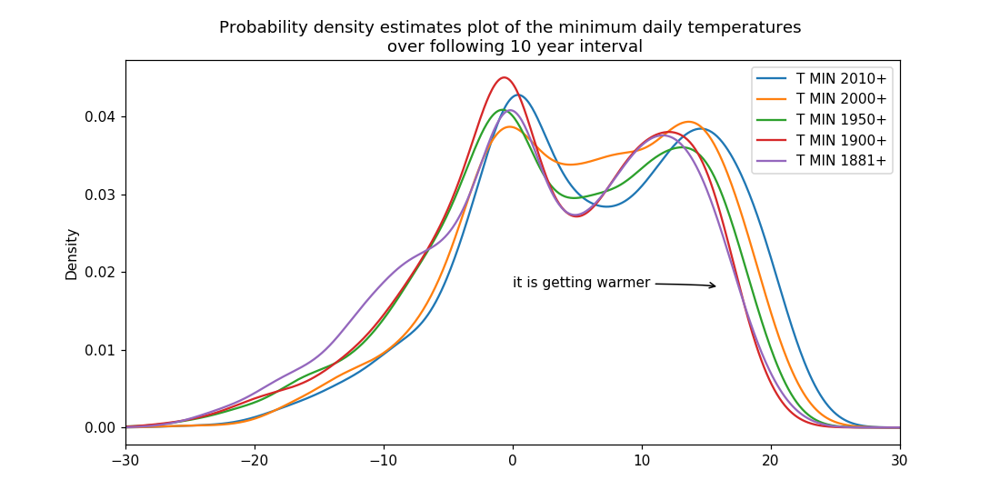

Text(0, 0.018, 'it is getting warmer')

In [98]:
from matplotlib import pyplot
import matplotlib

matplotlib.rc('figure', figsize=(10, 5))
length = 3755
series = pd.DataFrame({
    'T MIN 2010+': list(df7[ (df7["YEAR"]>2009)].DAILY_MIN)[:length],
    'T MIN 2000+': list(df7[ (df7["YEAR"]>1999)].DAILY_MIN)[:length],
    'T MIN 1950+': list(df7[ (df7["YEAR"]>1949)].DAILY_MIN)[:length],
    'T MIN 1900+': list(df7[ (df7["YEAR"]>1899)].DAILY_MIN)[:length],
    'T MIN 1881+': list(df7[ (df7["YEAR"]>1881)].DAILY_MIN)[:length]
})

ax = series.plot.kde(title = 'Probability density estimates plot of the minimum daily temperatures \n over following 10 year interval')
ax.set_xlim(left = -30, right=30)
ax.annotate('it is getting warmer', xy=(16, 0.018), xytext=(0, 0.018),
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="angle3,angleA=0,angleB=-90"),
            )

In [226]:
len(list(df7[ (df7["YEAR"]>2009)].DAILY_MIN))

3755

C:\Users\ATOM\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\ATOM\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:338: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<IPython.core.display.Javascript object>


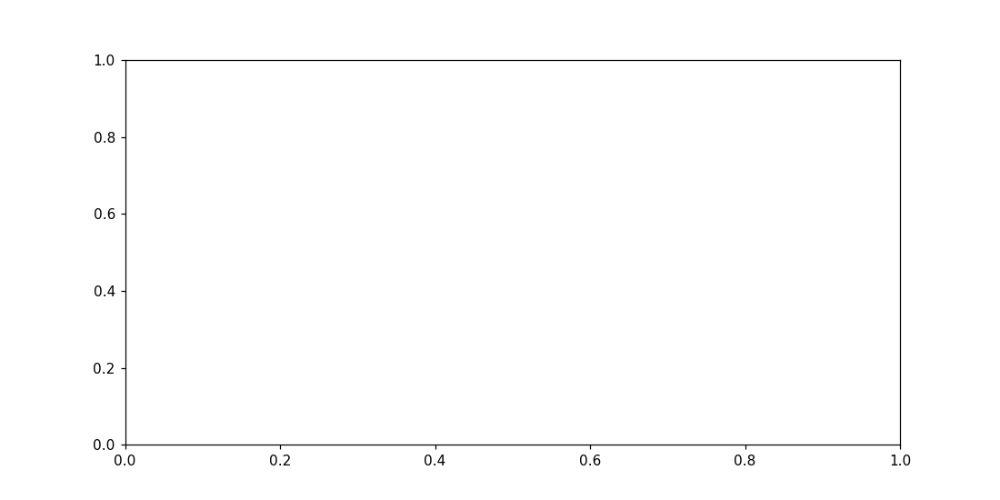

<IPython.core.display.Javascript object>


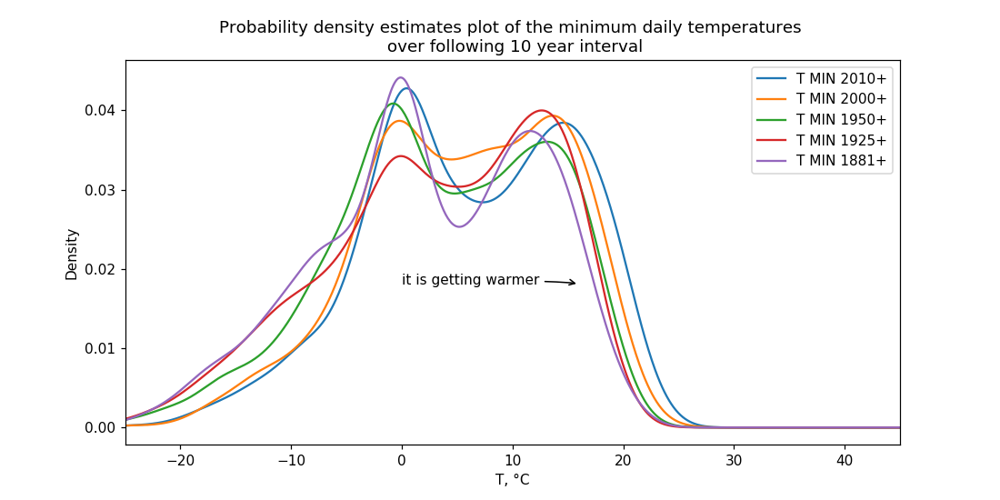

Text(0, 0.018, 'it is getting warmer')

In [241]:
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
matplotlib.rc('figure', figsize=(10, 5))
length = 3755
series = pd.DataFrame({
    'T MIN 2010+': list(df7[ (df7["YEAR"]>2009)].DAILY_MIN)[:length],
    'T MIN 2000+': list(df7[ (df7["YEAR"]>1999)].DAILY_MIN)[:length],
    'T MIN 1950+': list(df7[ (df7["YEAR"]>1949)].DAILY_MIN)[:length],
    'T MIN 1925+': list(df7[ (df7["YEAR"]>1924)].DAILY_MIN)[:length],
    'T MIN 1881+': list(df7[ (df7["YEAR"]>1880)].DAILY_MIN)[:length]
})

fig, ax = plt.subplots()
ax = series.plot.kde(title = 'Probability density estimates plot of the minimum daily temperatures \n over following 10 year interval')
ax.set_xlim(left = -25, right=45)
ax.set_xlabel("T, °C")
plt.show()

ax.annotate('it is getting warmer', xy=(16, 0.018), xytext=(0, 0.018),
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="angle3,angleA=0,angleB=-90"),
            )

In [242]:
# multiplicative decompose time series
import pandas as pd
import numpy as np
from matplotlib import pyplot
from statsmodels.tsa.seasonal import seasonal_decompose

fig, ax = plt.subplots()
#dates=list(np.linspace(1, 3756,3756))
series=pd.DataFrame(df7[ (df7["YEAR"]>1995)].DAILY_MEAN)
#print(len(values))
#series = pd.DataFrame(list(zip(dates, values)), 
#               columns =['N', 'T']) 

#series.interpolate(inplace=True)

series.isnull().values.any()

print(series.head())

_=seasonal_decompose(series, model='additive', freq = 365).plot()



C:\Users\ATOM\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\ATOM\Anaconda3\lib\site-packages\statsmodels\tsa\seasonal.py:179: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



       DAILY_MEAN
41426       -13.6
41427        -9.0
41428        -6.7
41429        -3.7
41430        -5.0


<IPython.core.display.Javascript object>


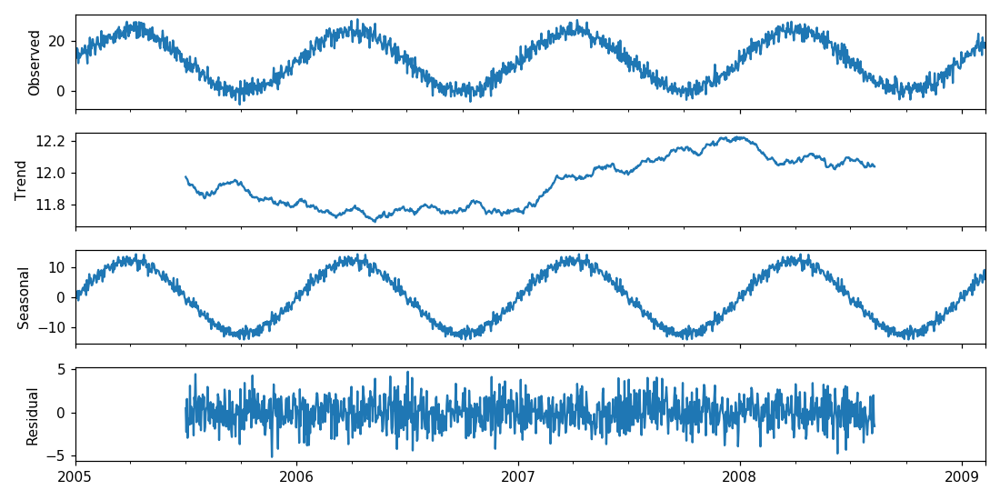

<IPython.core.display.Javascript object>


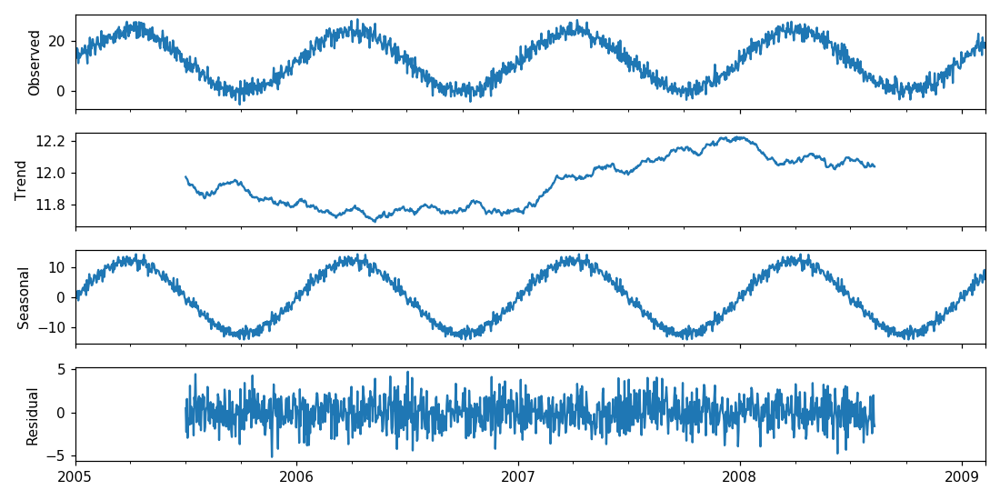

In [123]:


import numpy as np
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Generate some data
np.random.seed(0)
n = 1500
dates = np.array('2005-01-01', dtype=np.datetime64) + np.arange(n)
data = 12*np.sin(2*np.pi*np.arange(n)/365) + np.random.normal(12, 2, 1500)
df = pd.DataFrame({'data': data}, index=dates)

# Reproduce the example in OP
seasonal_decompose(df, model='additive', freq=365).plot()

NameError: name 'dataset' is not defined

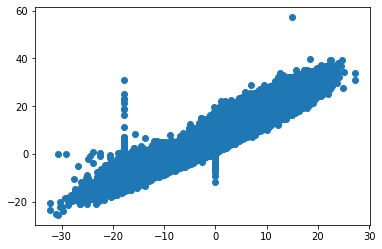

In [169]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.scatter(df7["DAILY_MIN"], df7["DAILY_MAX"])



In [170]:
import matplotlib.pyplot as plt
import pandas as pd

x = pd.Series(np.arange(50))
y = pd.Series(10 + (2 * x + np.random.randint(-5, + 5, 50)))
regression = pd.ols(y=y, x=x)
regression.summary

trend = regression.predict(beta=regression.beta, x=x[20:]) # slicing to only use last 30 points
data = pd.DataFrame(index=x, data={'y': y, 'trend': trend})
data.plot() # add kwargs for title and other layout/design aspects
plt.show() # or plt.gcf().savefig(path)


AttributeError: module 'pandas' has no attribute 'ols'

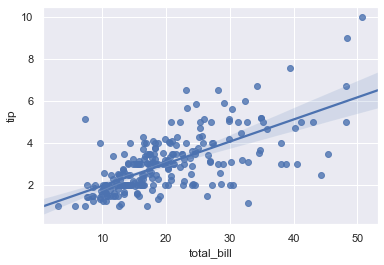

In [177]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(color_codes=True)

tips = sns.load_dataset("tips")
tips.head()
sns.regplot(x="total_bill", y="tip", data=tips);

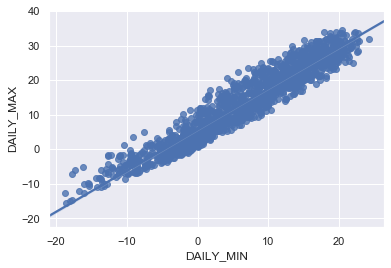

In [183]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(color_codes=True)

tips.head()
sns.regplot(x="DAILY_MIN", y="DAILY_MAX", data=df7[ (df7["YEAR"]>2015)]);

3.3915245278057674e-05 11.063923987076643 1.0 0.0 0.0


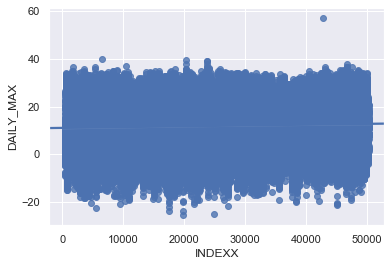

In [194]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy


sns.set(color_codes=True)

tips.head()
df77 = df7.copy(deep =True)
df77["INDEXX"] = df77.index
p= sns.regplot(x="INDEXX", y="DAILY_MAX", data=df77[ (df77["YEAR"]>1881)]);

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x=p.get_lines()[0].get_xdata(),y=p.get_lines()[0].get_ydata())
print(slope, intercept, r_value, p_value, std_err)

In [188]:
df7.index

RangeIndex(start=0, stop=50250, step=1)

<IPython.core.display.Javascript object>


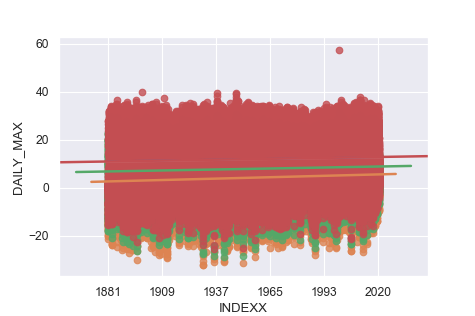

In [217]:
import matplotlib.pyplot as plt
%matplotlib notebook

fig, ax = plt.subplots()


plt.style_label="classic"
ex = list(np.linspace(0,50250, 52250))
ey = [ 3.3915245278057674e-05*x + 11.063923987076643 for x in ex]
plt.plot(ex, ey)
labels = ['','1881', '1909', '1937', '1965', '1993','2020']

ax.set_xticklabels(labels)
plt.title = "Average daily temperatures with time using linear regression"
plt.show()

<IPython.core.display.Javascript object>


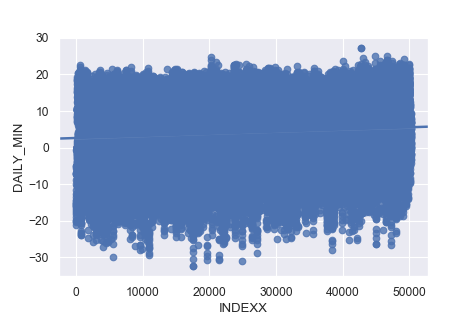

5.842804217460086e-05 2.64493410712056 1.0 0.0 0.0


In [223]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy


sns.set(color_codes=True)

tips.head()
df77 = df7.copy(deep =True)
df77["INDEXX"] = df77.index
p= sns.regplot(x="INDEXX", y="DAILY_MIN", data=df77[ (df77["YEAR"]>1880)]);

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x=p.get_lines()[0].get_xdata(),y=p.get_lines()[0].get_ydata())
print(slope, intercept, r_value, p_value, std_err)

In [ ]:
MIN 5.842804217460086e-05 2.64493410712056 1.0 0.0 0.0
MEAN = 4.09814909717529e-05 6.796480543505128 1.0 0.0 0.0
MAX = 3.744083671349111e-05 10.945711727842637 1.0 0.0 0.0
